# 11 Simulation : Grids and Multi-Agent Systems
## CLASS MATERIAL

<br> <a href='#Grid-BasedSimulations'>1. Grid-Based Simulations</a> 
<br> <a href='#SpatialVectorization'>2. Spatial Vectorization</a> 
<br><a href='#ReviewExercises'>3. Review Exercises</a>

# Download the new class notes.
__Navigate to the directory where your files are stored.__

__Update the course notes by downloading the changes__




##### Windows
Search for __Git Bash__ in the programs menu.

Select __Git Bash__, a terminal will open.

Use `cd` to navigate to *inside* the __ILAS_PyEng2019__ repository you downloaded. 

Run the command:
>`./automerge`



##### Mac
Open a terminal. 

Use `cd` to navigate to *inside* the __ILAS_PyEng2019__ repository you downloaded. 

Run the command:
>`sudo ./automerge`

Enter your password when prompted. 

### Lesson Goal

Learn how to construct grid and particle/agent based simulations and visualise the results through animation. 

### Fundamental programming concepts

- Using numpy arrays to contruct efficient grid and particle based simulations.
- Create animations of the results (.gif and .mp4 videos)

Computer simulation can be a useful tool for solving and visualising the behaviour of large collections of agents across multiple timesteps. 

__Agents__: individuals that interact with one another and their environment. 

Example agents:
- dicretised areas of an environment having one of a set of states
- particles in a chemical reaction
- swarm robots or biological organisms (flocking birds, humans) 

Using `for` loops is one way to cycle through each agent in a collection. 

For example, to cycle through every cell of an orthoganol grid, we could use:

```for x in X:
    for y in Y:
        ...
        ```

However, this is computationally costly and programatically inelegant. 

Python provides useful tools for:
- quickly and concisely solving the rules governing a simulation for large groups of agents.
- visualising the results as animations 

<a id='Grid-BasedSimulations'></a>
# 1. Grid-Based Simulations

<br> <a href='#ExampleWildfire'>1.1 Example : Wildfire</a>
<br> <a href='#ExampleGameLife'>1.2 Example : Game of Life</a> 


Orthoganol grids are a popular choice for spatial representation of environments as they allow for fast and easy solutions using numpy arrays. 



<a id='ExampleWildfire'></a>
## 1.1 Example : Wildfire
We can use a grid to model the spread of a fire.

__Problem setting:__
- A bounded area represented as an orthoganol grid is covered by either 
    - vegetation (`Fuel`)
    - `Clear` ground
- The centre-most cell is on fire (`Burning`)

The fire spreads with the following rules:
>If a cell is on fire in timestep $t$:
>- the cell is cleared in timestep $t+1$
>- all orthoganol neighbours congaining fuel are `Burning` in timestep $t+1$

<br><img src="img/neighbours.png" alt="Drawing" style="width: 200px;"/>

Install packages 
imageio

In [3]:
import numpy as np
import imageio
from numpy import ma as ma

In [4]:
prob = .6               # probability of a cell being fuel
timesteps = 300         # simulation time
height = 100            # grid height
width = 100             # grid width

In [5]:
# Cell States
C = 0 # Clear
F = 1 # Fuel
B = 2 # Burning

In [6]:
# array : grid at each timestep
states = np.zeros((timesteps, height, width)) 

np.random.seed(0) # the same random selection each time
 
# Create an initial random distribution of clear (0) and fuel (1) cells
states[0] = np.random.choice([C,F],                # possible cell value
                        size=[height, width],      # size of array
                        p=[1-prob,prob])           # probability of each value

# set centre cell on fire
states[0,height//2, width//2] = B

print(states[0])

[[1. 1. 1. ... 0. 1. 0.]
 [1. 0. 1. ... 0. 0. 1.]
 [0. 1. 0. ... 1. 1. 1.]
 ...
 [1. 0. 1. ... 1. 1. 0.]
 [0. 1. 1. ... 1. 1. 0.]
 [1. 0. 1. ... 1. 0. 1.]]


The grid has a one cell border that is not updated at each timestep.

```
for x in range(1,width-1):    
            for y in range(1,height-1):
            ```

<br><img src="img/neighbours.png" alt="Drawing" style="width: 200px;"/>

Let's forst consider the solution using `for` loops:

In [8]:
def iterate():
    "Cycles through each cell and checks if it should be clear, fuel or burning"
    for t in range(1,timesteps):       # At every timestep ...
        states[t] = states[t-1].copy() # ... make a copy of the previous timestep.

        for x in range(1,width-1):    # Loop through each cell (x,y value) on the grid        
            for y in range(1,height-1):

                if np.array_equal(states[t-1,x,y], B):         # If cell is on fire...

                    states[t,x,y] = C                          # ... clear cell                        

                    if np.array_equal(states[t-1,x+1,y], F):   # ...and set any orthoganol neighbours on fire 
                                    states[t,x+1,y] = B

                    if np.array_equal(states[t-1,x-1,y], F):
                                    states[t,x-1,y] = B    

                    if np.array_equal(states[t-1,x,y+1], F):
                                    states[t,x,y+1] = B    

                    if np.array_equal(states[t-1,x,y-1], F):
                                    states[t,x,y-1] = B  

In [9]:
iterate()

In [11]:
def make_gif(name):
    "Crops the simulation to a 200 frames (limit for gif). Saves animation as gif"
    # a grid to hold a colour representation of each cell 
    coloured = np.zeros((timesteps, height, width, 3),
                       dtype=np.uint8)


    # Color
    for t in range(timesteps): # each timestep

        coloured[t] = np.where(states[t].reshape(height, width, 1) == 0, 
                               np.array([139,69,19]).reshape(1,3) , 
                               coloured[t])
        
        coloured[t] = np.where(states[t].reshape(height, width, 1) == 1, 
                               np.array([0,255,0]).reshape(1,3)   , 
                               coloured[t])
        coloured[t] = np.where(states[t].reshape(height, width, 1) == 2, 
                               np.array([255,0,0]).reshape(1,3)   , 
                               coloured[t])

    # Crop
    cropped = coloured[
        :200,
        1:height-1,
        1:width-1
    ]

    #imageio.mimsave('./img/wildfire.gif', cropped)
    imageio.mimsave(name, cropped)

In [14]:
make_gif('./img/wildfire.gif')

<img src="img/wildfire.gif" alt="Drawing" style="width: 300px;"/>

Let's revisit the function `iterate`.

Instead of using for loops, we can create a set of rules that allow us to treat the environment as a single array. 



In [18]:
def iterate():
    "Cycles through each cell and checks if it should be clear, fuel or burning"
    for t in range(1,timesteps):                # At every timestep ...
        states[t] = states[t-1].copy()          # ... make a copy of the previous timestep.
        
        burn = ma.make_mask( states[t-1]==B )*1   # Make a map of burning cells
        
        print(burn)
        
        if burn.size==1:                        # If no cells are burning, stop the simulation
            break
                
        states[t] = states[t] - burn * 2        # Extinguish any burning cells from previous timestep
                             
        # Ignite any orthoganol neightbours of burning cells from previous timestep
        states[t,1:-1,1:-1] = states[t,1:-1,1:-1] + (states[t,1:-1,1:-1] * 
                           np.sign(
                           burn[ :-2, 1:-1] +
                           burn[1:-1, :-2] +
                           burn[1:-1, 2:] +
                           burn[2:  , 1:-1]
                          )
                                                     )
        



##### What does this code do?
Let's look at what each part of the new function does...

We cycle through each timestep, copying the previous timestep as before:
```python
def iterate():
    "Cycles through each cell : clear, fuel or burning?"
    for t in range(1,timesteps):       # At every timestep ...
        states[t] = states[t-1].copy() # ...copy previous timestep
        ```
        
        

```python
    burn = ma.make_mask(states[t-1]==B)*1   # map of burning cells
```

The function `make_mask` makes a mask of an array containing boolean values where a certain condition is true or false. 


`a = np.array([[2, 3],[1,4]])`

`ma.make_mask(a==2)`

__`>> [[True, False],[False, False]]`__

`ma.make_mask(a > 1) * 1`

__`>> [[1, 1],[0, 1]]`__






```
if burn.size==1:                  # If no cells are burning, stop the simulation
            break
        ```
        
If the condition is not True for any cell in the grid, `ma.make_map` will return a single value, 0.

There are several ways to deal with this, one way is to `break` out of the loop. 

Elementwise subtraction of the map of burning cells from the grid. 

`# Extinguish any burning cells from previous timestep
states[t] = states[t] - burn * 2  `

The sum of the four orthogonal neighbours of each cell can be found by finding the sum of the arrays one cell to the left, right, top and bottom of the region of interest `states[t,1:-1,1:-1` . 

`burn[ :-2, 1:-1] + burn[1:-1, :-2] + burn[1:-1, 2:] + burn[2:,1:-1]`

<img src="img/vectorize_array.png" alt="Drawing" style="width: 500px;"/>

```
# Ignite any orthoganol neightbours of burning cells from previous timestep
        states[t,1:-1,1:-1] = (states[t,1:-1,1:-1 + 
                                  (states[t,1:-1,1:-1] * 
                                       np.sign(
                                       burn[ :-2, 1:-1] +
                                       burn[1:-1, :-2] +
                                       burn[1:-1, 2:] +
                                       burn[2:  , 1:-1]
                                      )
                               )
                                                     ```

Let's run the code using the new function:

In [19]:
import numpy as np
import imageio

prob = .6               # probability of a cell being fuel
timesteps = 300         # simulation time
height = 100            # grid height
width = 100             # grid width


# Cell States
C = 0 # Clear
F = 1 # Fuel
B = 2 # Burning



In [20]:
# # array : grid at each timestep
states = np.zeros((timesteps, height, width)) 
 
# Create an initial random distribution of clear (0) and fuel (1) cells
states[0] = np.random.choice([C,F],                # possible cell value
                        size=[height, width], # size of array
                        p=[1-prob,prob])      # probability of each value


# set centre cell on fire
states[0,height//2, width//2] = B

iterate()

make_gif('./img/wildfire.gif')

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [

<img src="img/wildfire.gif" alt="Drawing" style="width: 300px;"/>

This type of simulation is known as a __cellular automata__. 

__Cellular Automata__
<br>A discrete model studied in computer science, mathematics, physics, complexity science, theoretical biology and microstructure modeling.

<br><img src="img/bacteria_compressed.gif
" alt="Drawing" style="width: 400px;"/>

A regular grid of cells, each in one of a finite number of states, such as on and off. 

<a id='ExampleGameLife'></a>
## 1.2 Example : Game of Life



The best-known example of a cellular automaton.

Devised by the British mathematician John Horton Conway in 1970. 

Zero-player game : evolution is determined by initial state (no input from human players). 

Model space : An infinite two-dimensional orthogonal grid of square cells.

Each cell has two possible states: live or dead. 

Every cell interacts with its 8 neighbours : cells that are directly horizontally, vertically, or diagonally adjacent. 



At each timestep:
    
- Any live cell with fewer than two live neighbours dies, as if by underpopulation.
- Any live cell with more than three live neighbours dies, as if by overcrowding.
- Any live cell with two or three live neighbours lives, unchanged, to the next generation.
- Any dead cell with exactly three live neighbours becomes a live cell.

In [21]:
prob = 0.2              # probability of a cell being fuel
timesteps = 300         # simulation time
height = 100            # grid height
width = 100             # grid width

# Cell States
ON = 1
OFF = 0

Populate the grid, as before

In [70]:
# populate grid with random on/off - more off than on
# # array : grid at each timestep
states = np.zeros((timesteps, height, width)) 

np.random.seed(0)
 
# Create an initial random distribution of OFF (0) and ON (1) cells
states[0] = np.random.choice([OFF,ON],                # possible cell value
                             size=[height, width],    # size of array
                             p=[1-prob,prob])         # probability of each value

print(states[0])

[[0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 1. 1. 1.]
 ...
 [1. 0. 1. ... 0. 0. 0.]
 [0. 0. 1. ... 1. 1. 0.]
 [1. 0. 0. ... 0. 0. 1.]]


We need to update the `iterate` function to be run at each timestep. 

There are two key differences from the last simulation. 

1. The game is played on an infinite surface : a toroid
<br><img src="img/torus.gif" alt="Drawing" style="width: 300px;"/>

2. Different rules to determine the next state

In contrast to the previous example (which had a bounding border of one cell):

- The upper neighbour of a cell in the top row is in the bottom row
- The lower neighbour of a cell in the bottom row is in the top row
- The left neighbour of a cell in the furtherst left column is in the furthest right column
- The right neighbour of a cell in the furtherst right column is in the furthest left column

We can use the `roll` function which rolls array elements along a given axis.

`np.roll( array,
          number of places to shift,
          axis to shift
         )`

In [23]:
def iterate():
    for t in range(1,timesteps):         # At every timestep ...
        states[t] = states[t-1].copy() # ... make a copy of the previous timestep.

        # compute 8-neghbor sum 
        # using toroidal boundary conditions - x and y wrap around 
        total = (np.roll(states[t], 1, 0) +
                 np.roll(states[t], -1, 0) + 
                 np.roll(states[t], 1, 1) +
                 np.roll(states[t], -1, 1) + 
                 np.roll(np.roll(states[t], 1, 0), 1, 1) +
                 np.roll(np.roll(states[t], -1, 0), -1, 1) +
                 np.roll(np.roll(states[t], 1, 0), -1, 1) +
                 np.roll(np.roll(states[t], -1, 0), 1, 1)) 
  
        # apply game of life rules
        states[t] = np.where((states[t-1] == ON)  &  ((total < 2) | (total > 3)), 
                             OFF, 
                             states[t])
        states[t] = np.where((states[t-1] == OFF) & (total == 3), 
                             ON, 
                             states[t])

In [24]:
iterate()

In [25]:
make_gif('./img/game_of_life.gif')

<img src="img/game_of_life.gif" alt="Drawing" style="width: 300px;"/>

The game of life has several patterns that oscillate : repeating infinitely until the game is stopped.

The glider is a pattern that travels across the board in Conway's Game of Life. 

<img src="img/Animated_glider_emblem.gif" alt="Drawing" style="width: 100px;"/>

The mutation and movement of a "glider".

In [26]:
# populate grid 
states = np.zeros((timesteps, height, width))

glider = [[1, 0, 0],
          [0, 1, 1],
          [1, 1, 0]]

states[0, :3, :3] = glider

iterate()

make_gif('./img/game_of_life_glider.gif')

<img src="img/game_of_life_glider.gif" alt="Drawing" style="width: 300px;"/>

An early question posed about the Game of Life was whether any configurations exist which result in asymptotically unbounded growth.

The following example is one of the most compact configurations which display unbounded growth.

Note : growth is unbounded on an infinite grid. On a torroidal grid growth is unbounded until the edge is reached, after that different results are produced.

In [80]:
# populate grid 
height = 30
width = 40
states = np.zeros((timesteps, height, width))

unbounded = [[1, 1, 1, 0, 1],
             [1, 0, 0, 0, 0],
             [0, 0, 0, 1, 1],
             [0, 1, 1, 0, 1],
             [1, 0, 1, 0, 1]]

states[0, 15:20, 18:23] = unbounded

iterate()

make_gif('./img/game_of_life_unbounded.gif')

<img src="img/game_of_life_unbounded.gif" alt="Drawing" style="width: 300px;"/>

The earliest known instance of unbounded growth is the "Glider Gun". 

It is an oscillating pattern that creates an infinite series of gliders.

In [27]:
# populate grid 
height = 100
width = 100
states = np.zeros((timesteps, height, width))

glider_gun =\
[[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1],
 [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1],
 [1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
 [1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0],
 [0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]]


states[0, 1:10, 1:37] = glider_gun

iterate()

make_gif('./img/game_of_life_glider_gun.gif')

<img src="img/game_of_life_glider_gun.gif" alt="Drawing" style="width: 300px;"/>

By applying different:
- sets of rules
- initial conditions 
to the grid, systems such as chemical reactions, population dynamics and biological systems such as neurons and patterning on shells/skin.

We are now going to consider a different method of producing animation that can be applied not only to grid-based simulation but to any figure constructed using `matplotlib`. 

This will be convenient for the simulations of rigid body dynamics that we will study next week. 



In [28]:
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.animation as animation
from matplotlib.animation import FFMpegWriter
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

These are the steps for creating an animation using the `matplotlib.animation` package:

1. Variables
1. Figure window
1. Axes within the figure window.
1. Object(s) to animate
1. Function (e.g. `animate`) to update simulation as a function of time
1. Use the function `animation.FuncAnimation` to create the animation.

In [29]:
# 1. Variables 
prob = 0.2              # probability of a cell being fuel
timesteps = 300         # simulation time
height = 100            # grid height
width = 100             # grid width

# Cell States
ON = 1
OFF = 0

In [31]:
# populate a single 2D grid 
#states = np.zeros((height, width)) 

np.random.seed(0)
 
# Create an initial random distribution of clear (0) and fuel (1) cells
states = np.random.choice([OFF,ON],                # possible cell value
                          size=[height, width],    # size of array
                          p=[1-prob,prob])         # probability of each value

print(states[0])

[0 0 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 1 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 1 0 1 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0]


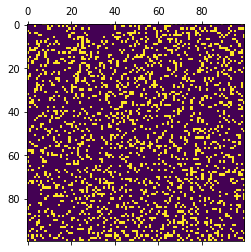

In [32]:
fig, ax = plt.subplots()   # 2,3 Figure + axes
mat = ax.matshow(states)   # 4. Object to animate : input array as a colour matrix 

We need to write a function that updates a figure of the grid each time it is called.

The function should have __one input, the frame number__, even if it is not used in the function. 

In [36]:
# 5. Function to update simulation
def iterate(data):
    "A function to update the game of life simulation using the neighbour rules"  

    # Make states a glocal variable
    global states  

    # Copy grid 
    newState = states.copy()

    # Compute 8-neghbor sum 
    total = (np.roll(newState, 1, 0) +
           np.roll(newState, -1, 0) + 
           np.roll(newState, 1, 1) +
           np.roll(newState, -1, 1) + 
           np.roll(np.roll(newState, 1, 0), 1, 1) +
           np.roll(np.roll(newState, -1, 0), -1, 1) +
           np.roll(np.roll(newState, 1, 0), -1, 1) +
           np.roll(np.roll(newState, -1, 0), 1, 1)) 

    # Apply rules
    newState = np.where((states == ON)  &  ((total < 2) | (total > 3)), OFF, newState)
    newState = np.where((states == OFF) & (total == 3), ON, newState)  

    # Update figure using the set_data function
    mat.set_data(newState)
    
    states = newState
    
    # For animation the current figure must be returned
    return [mat]

The function to create the animation `FuncAnimation` takes several arguments, including the `iterate` function. 

In [37]:
# 6. Create animation object
ani = animation.FuncAnimation(fig,           # The figure object to animate
                              iterate,       # Function to call at each frame
                              interval=50,   # Delay between frames ms (default = 2)
                              frames=30  # Number of frames
                             )

# Create the animation
ani

#writer = FFMpegWriter(fps=15, metadata=dict(artist='Me'), bitrate=1800) 

 
ani.save("img/game_of_life_anim.mp4", writer=writer)

In [39]:
from IPython.display import HTML
HTML(ani.to_jshtml())

<a id='SpatialVectorization'></a>
# 2. Spatial Vectorization


Where elements share the same computation but interact with only a subgroup of other elements. 

This was already the case for the cellular automata examples.

In more realistic situations there is an added difficulty because the subgroup is often dynamic and needs to be updated at each iteration:
- particle systems where particles interact mostly with local neighbours. 
- "boids" that simulate flocking behaviors.

<img src="img/flocking.gif" alt="Drawing" style="width: 300px;"/>

## Example : Boids 

An artificial life program, developed by Craig Reynolds in 1986, which simulates the flocking behaviour of birds. 

The name "boid" corresponds to a shortened version of "bird-oid object", which refers to a bird-like object.

Boids is an example of emergent behavior; the complexity of Boids arises from the interaction of individual agents (the boids).



Interaction is governed by a set of simple rules that determine the boids acceleration and velocity: 

- __separation__: steer to avoid crowding local flock-mates
- __alignment__: steer towards the average heading of local flock-mates
- __cohesion__: steer to move toward the average position (center of mass) of local flock-mates


<img src="img/boids.png" alt="Drawing" style="width: 400px;"/>

In [40]:
import numpy as np 

In [41]:
boid_count = 10     # number of boids

In [42]:
height = 2000
width = 2000
limits = np.array([height, width])   # define edges of simulation environment

In [4]:
np.random.seed(0)

# create 2 x boid_count array of random values in range [0,1]
positions = np.random.rand(2, boid_count) 

# Mulitply by size of environment to get random poitions
positions *= limits[:, np.newaxis] 

# initial position of each boid
positions 

array([[1097.62700785, 1430.37873274, 1205.52675214, 1089.76636599,
         847.30959868, 1291.78822613,  875.17442253, 1783.54600156,
        1927.325521  ,  766.88303765],
       [1583.45007617, 1057.78983951, 1136.08912219, 1851.19327659,
         142.0721164 ,  174.2585994 ,   40.43679488, 1665.2396911 ,
        1556.3135019 , 1740.02429649]])

#### What does this code do?

The `newaxis` expression is used to increase the dimension of the existing array by one more dimension

`limits[:, np.newaxis] `


This reshapes the 1-dimensional array `limits` to allow the following multiplication to take place.

Multiply a 2×10 array  by a 2×1 array – and get a 2×10 array.
<br>`positions = np.random.rand(2, boid_count) * limits[:, np.newaxis] `

(In this case, it is has the same result as `limits[:].reshape(2,1)`)

\begin{align*}
p &= p_{min} + D(p_{max} - p_{min})\\
\begin{bmatrix} p_x \\ p_y \end{bmatrix}
  &= \begin{bmatrix} p_{x,min} \\ p_{y,min} \end{bmatrix} 
     + D 
     \left(
     \begin{bmatrix} p_{x,max} \\ p_{y,max} \end{bmatrix} - 
     \begin{bmatrix} p_{x,min} \\ p_{y,min} \end{bmatrix}
     \right)
\end{align*}

where $D$ is a random number in range 0 to 1

In [43]:
def new_flock(count, minimum, maximum):
    
    return (minimum[:, np.newaxis] + 
            np.random.rand(2, count) * 
            (maximum - minimum)[:, np.newaxis])

Let’s assume that we want our initial positions to vary between 100 and 200 in the x axis, and 900 and 1100 in the y axis. 

We can generate random positions within these constraints with:

In [45]:
positions = new_flock(boid_count, 
                      np.array([100, 900]), 
                      np.array([200, 1100]))

Each bird will also need a starting velocity. 

Let’s make these random.

Let's let initial x velocities range over [0,10] and the y velocities over [−20,20].

In [46]:
velocities = new_flock(boid_count, 
                       np.array([0, -20]), 
                       np.array([10, 20]))
velocities

array([[  5.56446876,   9.26600797,   1.56222383,   8.67329613,
          5.00238931,   9.24456174,   8.2235505 ,   4.42980031,
          0.88711771,   0.30197455],
       [ 14.96923239,  -1.0286033 ,   6.54779632,  15.26593657,
         -7.81364034,  15.83052074, -18.89870242,  -8.80297285,
         12.4706558 ,  14.12881273]])

To find the position in the next timestep according to:

$p_t = p_{t-1} + v_{t-1}$

where:
<br>$p=$ position of each bird
<br>$v=$ velocity of each bird

In [47]:
positions += velocities

### Animate
Now we can animate our Boids, again by using the matplotlib animation tools.

In [48]:
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.animation as animation
from matplotlib.animation import FFMpegWriter
from matplotlib import animation, rc
from IPython.display import HTML
%matplotlib inline

These are the steps for creating an animation using the `matplotlib.animation` package:

1. Variables
1. Figure window
1. Axes within the figure window.
1. Object(s) to animate
1. Function (e.g. `animate`) to update simulation as a function of time
1. Use the function `animation.FuncAnimation` to create the animation.

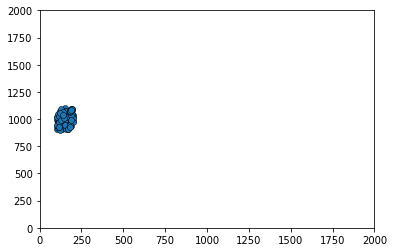

In [51]:
# 1. Variables : define positions and velocities
positions = new_flock(100, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(100, np.array([0, -20]), np.array([10, 20]))

# 2. Figure window
figure = plt.figure()                   

# 3. Axes within the figure window
axes = plt.axes(xlim=(0, limits[0]),    # choose the figure size
                ylim=(0, limits[1]))

# 4. Object to animate : scatter plot
scatter = axes.scatter(positions[0, :], # x values
                       positions[1, :], # y values
                       marker='o', 
                       edgecolor='k', 
                       lw=0.5)

The function to run to update each frame of the animation:

In [52]:
def update_boids(positions, velocities):
    "Updates the position of each boid"
    positions += velocities

def animate(frame):
    update_boids(positions, velocities)
    # change the positions in the figure
    scatter.set_offsets(positions.transpose())   

Create the animation using `FuncAnimation`:

In [53]:
anim = animation.FuncAnimation(figure,      # The figure object to animate 
                               animate,     # Function to call at each frame
                               frames=50,   # Delay between frames ms (default = 2)
                               interval=50) # Number of frames

In [54]:
anim.save('img/boids_basic.mp4')

In [14]:
from IPython.display import HTML
HTML(anim.to_jshtml())

### Cohesion

Boids try to fly towards the centre of mass of the group

In [15]:
positions = new_flock(4, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(4, np.array([0, -20]), np.array([10, 20]))

COM = np.mean(positions, 1) # mean x and y position (along row axis)

positions.shape

(2, 4)

Find the x and y components of the vector from each position to the middle. 

In [16]:
cohesion = positions - COM[:, np.newaxis]

Substract the velocity pulling the boid towarsd the COM from the total velcoity of each individual. 

In [17]:
cohesion_strength = 0.01

velocities = velocities - (cohesion * cohesion_strength)

Let’s update our function, and animate that:

In [18]:
def update_boids(positions, velocities):
    # Cohesion
    cohesion_strength = 0.01                     # cohesion parameter
    COM = np.mean(positions, 1)                  # centre of mass of flock
    cohesion = positions - COM[:, np.newaxis]    # distance from each boid to COM
    velocities -= cohesion * cohesion_strength   # update velocities
    
    positions += velocities  # update positions
    
def animate(frame):
    update_boids(positions, velocities)
    scatter.set_offsets(positions.transpose())

In [19]:
positions = new_flock(4, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(4, np.array([0, -20]), np.array([10, 20]))

anim = animation.FuncAnimation(figure, 
                               animate,
                               frames=200, 
                               interval=50)

In [20]:
anim.save('img/boids_cohesion.mp4')


In [21]:
HTML(anim.to_jshtml())

### Seperation
Avoid collisions with nearby flockmates

We want to find the distance from every boid to every other boid (including itself). 

We can use broadcasting to subtract every value in an array from every value an array.

Example:

In [253]:
a = np.array([1, 2, 3, 4])

a

array([1, 2, 3, 4])

In [24]:
a[np.newaxis, :]

array([[1, 2, 3, 4]])

In [25]:
a[:, np.newaxis]

array([[1],
       [2],
       [3],
       [4]])

In [26]:
a[np.newaxis, :] - a[:, np.newaxis]

array([[ 0,  1,  2,  3],
       [-1,  0,  1,  2],
       [-2, -1,  0,  1],
       [-3, -2, -1,  0]])

In [27]:
(a[np.newaxis, :] - a[:, np.newaxis]).shape

(4, 4)

We can subtract all x,y positions...

In [28]:
positions[:, np.newaxis, :].shape

(2, 1, 4)

...from all x,y positions

In [29]:
positions[:, :, np.newaxis].shape

(2, 4, 1)

In [30]:
separations = positions[:, np.newaxis, :] - positions[:, :, np.newaxis]

In [31]:
separations.shape

(2, 4, 4)

In [32]:
positions = new_flock(4, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(4, np.array([0, -20]), np.array([10, 20]))

Find the elementwise sum of squared x and y value for each distance

In [33]:
sum_square_dis = np.sum(separations**2, 0)
sum_square_dis.shape

(4, 4)

In [34]:
alert_distance = 2000
close_birds = sum_square_dis < alert_distance
close_birds

array([[ True, False, False, False],
       [False,  True,  True, False],
       [False,  True,  True, False],
       [False, False, False,  True]])

Find the direction distances only to those birds which are too close:

In [35]:
separations_if_close = np.copy(separations) # copy of all distances

far_map = np.logical_not(close_birds)      # map of far away birds
far_map


array([[False,  True,  True,  True],
       [ True, False, False,  True],
       [ True, False, False,  True],
       [ True,  True,  True, False]])

Set x and y values in separations_if_close to zero if they are far away:

In [36]:
separations_if_close[0, :, :][far_map] = 0 # x values
separations_if_close[1, :, :][far_map] = 0 # y values
separations_if_close 
separations_if_close.shape

(2, 4, 4)

Sum of x distance and y distance to closest boids for each boid

In [37]:
np.sum(separations_if_close, 2) 

array([[  0.        , -15.16861779,  15.16861779,   0.        ],
       [  0.        , -40.04136691,  40.04136691,   0.        ]])

Add the velocity seperating the boids to the total velcoity of each individual.

In [38]:
velocities = velocities + np.sum(separations_if_close, 2)

Let's update the `update_boids` function to include the seperation rule:

In [51]:
def update_boids(positions, velocities):
    # Cohesion
    cohesion_strength = 0.01                      # cohesion parameter
    COM = np.mean(positions, 1)                   # centre of mass of flock
    cohesion = positions - COM[:, np.newaxis]     # distance from each boid to COM
    velocities -= cohesion * cohesion_strength    # update velocities

    # Seperation
    separations = positions[:, np.newaxis, :] - positions[:, :, np.newaxis] # all distances between boids 
    sum_squared_dis = np.sum(separations**2, 0)   # sum of squared distances
    alert_distance = 100                          # threshold for seperation
    far_map = sum_squared_dis > alert_distance    # boolean map of far boids 
    separations_if_close = np.copy(separations)   # copy of all distances between boids 
    separations_if_close[0, :, :][far_map] = 0    # remove far boids
    separations_if_close[1, :, :][far_map] = 0
    velocities += np.sum(separations_if_close, 1) # update velocity of boids

    positions += velocities  # update positions
    
def animate(frame):
    update_boids(positions, velocities)
    scatter.set_offsets(positions.transpose())

In [52]:
positions = new_flock(100, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(100, np.array([0, -20]), np.array([10, 20]))

anim = animation.FuncAnimation(figure, 
                               animate,
                               frames=200, 
                               interval=50)




In [53]:
anim.save('img/boids_seperation.mp4')

HTML(anim.to_jshtml())

### Alignment 

Attempt to match velocity with nearby flockmates

In [57]:
def update_boids(positions, velocities):
    # Cohesion
    cohesion_strength = 0.01                      # cohesion parameter
    COM = np.mean(positions, 1)                   # centre of mass of flock
    cohesion = positions - COM[:, np.newaxis]     # distance from each boid to COM
    velocities -= cohesion * cohesion_strength    # update velocities

    # Seperation
    separations = positions[:, np.newaxis, :] - positions[:, :, np.newaxis] # all distances between boids 
    sum_squared_dis = np.sum(separations**2, 0)   # sum of squared distances
    alert_distance = 100                          # threshold for seperation
    far_map = sum_squared_dis > alert_distance    # boolean map of far boids 
    separations_if_close = np.copy(separations)   # copy of all distances between boids 
    separations_if_close[0, :, :][far_map] = 0    # remove far boids
    separations_if_close[1, :, :][far_map] = 0
    velocities += np.sum(separations_if_close, 1) # update velocity of boids

    # Alignment
    velocity_dif = velocities[:, np.newaxis, :] - velocities[:, :, np.newaxis] # all differences in velocity between boids 
    form_flying_distance = 10000                                # threshold for formation flying
    form_flying_strength = 0.125                                # formation flying parameter
    very_far_map = sum_squared_dis > form_flying_distance       # boolean map of very far boids
    velocity_dif_if_close = np.copy(velocity_dif)               # copy of all differences in velocity between boids 
    velocity_dif_if_close[0, :, :][very_far_map] = 0            # remove very far boids
    velocity_dif_if_close[1, :, :][very_far_map] = 0
    velocities -= np.mean(velocity_dif_if_close, 1) * form_flying_strength     # update velocity of boids

    positions += velocities                       # update positions
    


In [ ]:
def animate(frame):
    update_boids(positions, velocities)
    scatter.set_offsets(positions.transpose())

In [60]:
positions = new_flock(100, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(100, np.array([0, -20]), np.array([10, 20]))

anim = animation.FuncAnimation(figure, 
                               animate,
                               frames=400, 
                               interval=50)

In [62]:
anim.save('img/boids_alignment.mp4')

HTML(anim.to_jshtml())

Our boids eventually travel outside of the plot window. 

Like the previous simulations we can setconditions that effect the boundary of the simulation. 

In the boids simulation, the boids avoid the walls by *steering*, heading away from the wall on a heading normal to it's surface.

The wall does not provide a physical boundary in this case.

The boid can, for example, fly through the boundary. 

We define parameters for the distance from the wall at which we want a repulsive force to act. 

In [63]:
wall_alert_distance = 1
wall_strength = 1

In [64]:
positions = new_flock(10, np.array([100, 900]), np.array([200, 1100]))
velocities = new_flock(10, np.array([0, -20]), np.array([10, 20]))

In [65]:
right = np.copy(positions[0, :]) - width    # x distance from roght wall
far_map = right < wall_alert_distance       # map of x vals far from wall
right[far_map] = 0                          # remove boids far from wall
velocities[0, :] +=  right * -wall_strength # update velocity of boids close to wall   
    

In [66]:
def update_boids(positions, velocities):
    # Cohesion
    cohesion_strength = 0.01                      # cohesion parameter
    COM = np.mean(positions, 1)                   # centre of mass of flock
    cohesion = positions - COM[:, np.newaxis]     # distance from each boid to COM
    velocities -= cohesion * cohesion_strength    # update velocities

    # Seperation
    separations = positions[:, np.newaxis, :] - positions[:, :, np.newaxis] # all distances between boids 
    sum_squared_dis = np.sum(separations**2, 0)   # sum of squared distances
    alert_distance = 100                          # threshold for seperation
    far_map = sum_squared_dis > alert_distance    # boolean map of far boids 
    separations_if_close = np.copy(separations)   # copy of all distances between boids 
    separations_if_close[0, :, :][far_map] = 0    # remove far boids
    separations_if_close[1, :, :][far_map] = 0
    velocities += np.sum(separations_if_close, 1) # update velocity of boids

    # Alignment
    velocity_dif = velocities[:, np.newaxis, :] - velocities[:, :, np.newaxis] # all differences in velocity between boids 
    form_flying_distance = 10000                                # threshold for formation flying
    form_flying_strength = 0.125                                # formation flying parameter
    very_far_map = sum_squared_dis > form_flying_distance       # boolean map of very far boids
    velocity_dif_if_close = np.copy(velocity_dif)               # copy of all differences in velocity between boids 
    velocity_dif_if_close[0, :, :][very_far_map] = 0            # remove very far boids
    velocity_dif_if_close[1, :, :][very_far_map] = 0
    velocities -= np.mean(velocity_dif_if_close, 1) * form_flying_strength     # update velocity of boids

    # Simulate wall
    wall_alert_distance = 1
    wall_strength = 3
    
    left = np.copy(positions[0, :])                # x distance from left wall
    far_map = left > wall_alert_distance           # map of x vals far from left wall
    left[far_map] = 0                              # remove boids far from wall
    velocities[0, :] += left * -wall_strength      # update velocity of boids close to wall   
    
    right = np.copy(positions[0, :]) - width        # x distance from right wall
    far_map = right < wall_alert_distance           # map of x vals far from wall
    right[far_map] = 0                              # remove boids far from wall
    velocities[0, :] +=  right * -wall_strength     # update velocity of boids close to wall   
    
    top = np.copy(positions[1, :]) 
    far_map = top > wall_alert_distance
    top[far_map] = 0
    velocities[1, :] +=  top * -wall_strength 
    
    bottom = np.copy(positions[1, :]) - height
    far_map = bottom < wall_alert_distance
    bottom[far_map] = 0
    velocities[1, :] +=  bottom * -wall_strength 
    
    positions += velocities                       # update positions
    
def animate(frame):
    update_boids(positions, velocities)
    scatter.set_offsets(positions.transpose())

In [67]:
# bounce off right wall
positions = new_flock(100, np.array([500, 900]), np.array([700, 1100]))
velocities = new_flock(100, np.array([0, -20]), np.array([10, 20])) 

anim.save('img/boids_rightbounce.mp4')

HTML(anim.to_jshtml())

In [ ]:
# bounce off left wall
positions = new_flock(100, np.array([500, 900]), np.array([700, 1100]))
velocities = new_flock(100, np.array([0, -20]), np.array([10, 20])) # right bounce

anim.save('img/boids_leftbounce.mp4')

HTML(anim.to_jshtml())

In [ ]:
# bounce off top wall
positions = new_flock(100, np.array([500, 900]), np.array([700, 1100]))
velocities = new_flock(100, np.array([-20, -10]), np.array([20, 0])) # bottom bounce

anim.save('img/boids_topbounce.mp4')

HTML(anim.to_jshtml())

In [ ]:
# bounce off top wall
positions = new_flock(100, np.array([500, 900]), np.array([700, 1100]))
velocities = new_flock(100, np.array([-20, 0]), np.array([20, 10])) # top bounce

anim.save('img/boids_bottombounce.mp4')

HTML(anim.to_jshtml())

In [204]:
# random direction
positions = new_flock(100, np.array([500, 900]), np.array([700, 1100]))
velocities = new_flock(100, np.array([-40, -60]), np.array([40, 50])) # top bounce



anim = animation.FuncAnimation(figure, 
                               animate,
                               frames=200, 
                               interval=20)


anim.save('img/boids_alignment.mp4')

HTML(anim.to_jshtml())

To add more complex environemnts and behaviours, we need a new appraoch that allows us to handle large numbers of individuals.

<img src="img/boids01.gif" alt="Drawing" style="width: 300px;"/>

This will be the topic of next weeek's class. 

By creating layers of numpy arrays you can produce simulate complex and realistic behaviour quickly without requiring much memory. 

For example, you could introduce another array `accelerations`:  
- gravity acting on every particle
- acceleration due to a collision

# Summary
- Grid-based simulations are a fast and computationally light way to model complex and rule-based systems and environments.
- Numpy arrays are a useful way to represent a grid-based simulation due to built-in elementwise operations and broadcasting.
- Python provides a number of ways for creating animated visualisations of simulation data : 
    - capturing an RGB colour array as a .gif file
    - using the `matplotlib.animation` package to animate a figure
    
- Python arrays are can also be useful way to represent large collections of interacting (simple!) agents.

<br><img src="img/Reaction-Diffusion_3D.gif
" alt="Drawing" style="width: 200px;"/>

<a id='ReviewExercises'></a>
# 3. Review Exercises

# Review Exercise 1 : Game of Life

Create recreating the game of life example. 

Try populating the grid with different starting conditions (you can find some famous initial conditions by searching the internet).

Try changing the rules of the game. 

Save the results of your simulation as an animation. 

# Review Exercise 2 : Particles in a box

In the boids simulation, the boids avoid the walls by *steering*, heading away from the wall on a heading normal to it's surface.

The wall does not provide a physical boundary in this case.

The boid can, for example, fly through the boundary. 

Let's change the problem setting slightly.

- 10 particles
- random starting position
- random starting velocity
- particles can occupy the same space (ignore collisions with other particles)
- if a particle collides with the simulation boundary, it bounces off...



The basic principle when bouncing is that the incoming angle shoudl be equal to the outgong angle. 

<img src="img/ball.png" alt="Drawing" style="width: 300px;"/>

We can buid a simple kinematic model of the particle collision by neglecting forces (e.g. friction):
- if a particle hits a surface parallel to x axis, $v_y = v_y \times - 1$#
- if a particle hits a surface parallel to y axis, $v_x = v_x \times - 1$

Build a simulation of the problem setting described.

Save an animation of your simulation.

In [252]:
import io 
import base64 
from IPython.display import HTML
video = io.open('img/bouncing_particles.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video width = "500"  alt="test" controls>
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii')))

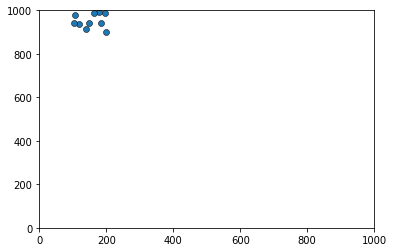

In [248]:
# Example Solution 
height = 1000
width = 1000
limits = np.array([height, width])   # define edges of simulation environment


# Define positiona and velcoities
positions = new_flock(10, np.array([100, 900]), np.array([200, 1000]))
velocities = new_flock(10, np.array([-40, -20]), np.array([30, 20]))

# Set up figure to animate : scatter plot
figure = plt.figure()                   # create a figure 

axes = plt.axes(xlim=(0, limits[0]),    # choose the figure size
                ylim=(0, limits[1]))

scatter = axes.scatter(positions[0, :], # x values
                       positions[1, :], # y values
                       marker='o', 
                       edgecolor='k', 
                       lw=0.5)


def update_boids(positions, velocities):
    "A function to update in each timestep of the simulation"
    
    # Simulate wall
    wall_alert_distance = 1
    
    left = np.copy(positions[0, :])                
    near_map = left < wall_alert_distance           
    velocities[0, near_map]*=-1

    
    right = np.copy(positions[0, :]) - width        
    near_map = right > wall_alert_distance          
    velocities[0, near_map] *= -1                            
    
    
    top = np.copy(positions[1, :]) 
    near_map = top < wall_alert_distance
    velocities[1, near_map] *= -1
    
    bottom = np.copy(positions[1, :]) - height
    near_map = bottom > wall_alert_distance
    velocities[1, near_map] *= -1
    
    positions += velocities                       
    
def animate(frame):
    update_boids(positions, velocities)
    scatter.set_offsets(positions.transpose())

In [250]:
anim = animation.FuncAnimation(figure, 
                               animate,
                               frames=200, 
                               interval=20)


anim.save('img/bouncing_particles.mp4')

HTML(anim.to_jshtml())